In [19]:
#Importing necessary libraries
import requests
import numpy as np
import pandas as pd
import plotly.express as px
import json
from urllib.request import urlopen
import folium.plugins
import random
from datetime import datetime, timedelta
import io
import base64
import folium
from scipy.spatial import Delaunay
import matplotlib.cm as cm
import matplotlib.colors as colors
import matplotlib.pyplot as plt
import networkx as nx
from scipy.spatial.distance import euclidean
from matplotlib.colors import Normalize
from matplotlib.cm import ScalarMappable, viridis
from folium.plugins import MarkerCluster, TimeSliderChoropleth
from scipy.interpolate import griddata
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler, LabelEncoder

The randomized dataset was created. 

Code feautures the use of advanced computation techniques Delaunay triangulation. Delone triangulation of a set of points in the plane subdivides their convex hull into triangles whose circumcircles do not contain any of the points, which in turn corresponds to the dual graph of the Voronoi diagram.

After discretization the data is interplated to a 2d grid. The interpolant is a bilinear polynomial, which is also a harmonic function satisfying Laplace's equation. Its graph is a bilinear Bézier surface patch.

PageRank is used in network science for assigning importance score web pages. The analogy is drawn to identify most important antennaes and the least important ones. The graph is converted to H matrix based on their distances from each other, after the google matrix of graph is calculated. 

The countour plots for signal intensity of antennae were obtained and compared with those obtained from 2-d interpolation of user tests. By calculating the difference between the two, the anomalies were detected and displayed.

Kmeans and PCA clustering.

The maps are produced using Folium, with some parts written in HTML, CSS, JS. Heavy use of matplotlib libraries.
Co

### Documentation


### 1. Importing Libraries
The script begins by importing a wide range of Python libraries essential for data manipulation, visualization, and machine learning. Libraries such as `pandas` and `numpy` handle data manipulation, `matplotlib`, `plotly`, and `folium` are used for visualization, and `scikit-learn` provides tools for machine learning tasks.

### 2. Generating Synthetic Data
To simulate real-world scenarios, the script generates a synthetic dataset. This dataset includes attributes like latitude, longitude, upload and download speeds, latency, network type, and device type. Random values are assigned to these attributes to create a comprehensive dataset, which is then saved into a DataFrame for further processing.

### 3. Saving and Preprocessing Data
The synthetic data is sorted by timestamp and saved as a CSV file. Preprocessing involves standardizing the data, ensuring that each feature has a mean of zero and a standard deviation of one. This step is crucial for the performance of machine learning algorithms, which assume that all features contribute equally to the analysis.

### 4. Data Visualization
Visualization is a key component of the script. Various plots are created to understand the data better. Contour maps and scatter plots provide insights into the distribution and relationships between different data points. An interactive map using `Folium` visualizes geographical data, displaying upload speeds across different locations with color coding and clustering for better clarity.

### 5. Creating Interactive Maps
Using `Folium`, the script creates an interactive map centered on Baku, Azerbaijan. This map displays data points with functionalities like clustering, Delaunay triangulation (to understand spatial relationships), and color coding to represent different upload speeds. Additional features like fullscreen mode and search widgets enhance the map’s usability.

### 6. Machine Learning: PCA and K-means Clustering
Principal Component Analysis (PCA) is applied to reduce the dimensionality of the data, transforming it into a set of uncorrelated components. This makes the data easier to visualize and analyze. Following PCA, K-means clustering is used to identify patterns within the data. The elbow method determines the optimal number of clusters, helping group similar data points together and uncovering hidden patterns and anomalies.

### 7. Graph Analysis and PageRank Calculation
A network graph is generated from the data points, with nodes representing locations and edges representing connections based on proximity. The PageRank algorithm is applied to determine the importance of each node in the network. This analysis helps identify key locations based on their connectivity and influence within the network.

### 8. Anomaly Detection and Theoretical Model Comparison
Anomaly detection is performed by comparing actual upload speed data with a theoretical model. Interpolation techniques create a smooth grid of upload speeds, which is then compared to theoretical values. This comparison helps identify discrepancies and anomalies in the data, providing insights into areas that deviate from expected behavior.

### 9. Number-Based Visualization
Groups are used for visualization of the distribution of users, showing how upload speeds vary over time. This interactive map allows users to explore changes in data throughout the region, providing a dynamic view of the dataset.

### 10. Sending Results to a Server
The script includes functionality (currently commented out) to send generated maps and data to a server via HTTP POST requests. This feature allows for remote storage and further processing of the visualizations, facilitating broader access and analysis.

## Conclusion
Overall, the script offers a detailed workflow for analyzing and visualizing upload and download speed data. By combining data generation, preprocessing, interactive visualizations, and advanced machine learning techniques, it provides valuable insights and makes the analysis accessible even to those unfamiliar with the underlying data science principles.


### Import dataset from mySQL

In [21]:
# # Define the address
# url = 'http://192.168.252.152:8080/test-logs'

# # Send a GET request
# response = requests.get(url)

# # Check the status code of the response
# if response.status_code == 200:
#     print("Success!")
# else:
#     print(f"Failed with status code: {response.status_code}")

# # Print the content of the response (optional)
# print(response.text)

# # Assuming the response is in JSON format, convert it to a DataFrame
# data = response.json()

# # Convert the JSON data to a Pandas DataFrame
# df = pd.DataFrame(data)

# # Save the DataFrame to a CSV file
# df.to_csv('test_logs.csv', index=False)

### Generate dataset

In [22]:
# Helper function to generate random dates within a range
def random_dates(start, end, n):
    start_u = start.timestamp()
    end_u = end.timestamp()
    return [datetime.fromtimestamp(random.uniform(start_u, end_u)) for _ in range(n)]

# Generate random data
num_samples = 10000
latitude = np.random.uniform(38, 42, num_samples)
longitude = np.random.uniform(44, 51, num_samples)
upload_speed = np.random.uniform(0, 100, num_samples)
download_speed = upload_speed + np.random.uniform(-10, 10, num_samples)  # Close to upload speed
latency = np.random.uniform(10, 200, num_samples)
time = np.random.uniform(0, 86400, num_samples)  # Time in seconds
created_at = random_dates(datetime(2020, 1, 1), datetime(2023, 12, 31), num_samples)
closest_cell_id = np.random.randint(1000, 10000, num_samples)
distance_to_the_closest_cell = np.random.uniform(0, 10, num_samples)
network_type = np.random.choice(['4G', '5G', 'LTE', '3G'], num_samples)
packet_loss = np.random.uniform(0, 5, num_samples)
device_name = np.random.choice(['iPhone', 'Samsung', 'Huawei', 'OnePlus'], num_samples)
device_type = np.random.choice(['Smartphone', 'Tablet', 'Laptop'], num_samples)
battery = np.random.uniform(0, 100, num_samples)
operator = np.random.choice(['OperatorA', 'OperatorB', 'OperatorC'], num_samples)
indoor = np.random.choice([True, False], num_samples)
outdoor = ~indoor  # If indoor is True, outdoor is False, and vice versa
customer_phone_number = [f"+994{random.randint(100000000, 999999999)}" for _ in range(num_samples)]

# Create DataFrame
df = pd.DataFrame({
    'customerPhoneNumber': customer_phone_number,
    'time': time,
    'latency': latency,
    'downloadSpeed': download_speed,
    'uploadSpeed': upload_speed,
    'latitude': latitude,
    'longitude': longitude,
    'createdAt': created_at,
    'closestCellId': closest_cell_id,
    'distanceToTheClosestCell': distance_to_the_closest_cell,
    'networkType': network_type,
    'packetLoss': packet_loss,
    'deviceName': device_name,
    'deviceType': device_type,
    'battery': battery,
    'operator': operator,
    'indoor': indoor,
    'outdoor': outdoor
})

# Convert 'createdAt' to SQL datetime format
df['createdAt'] = df['createdAt'].apply(lambda x: x.strftime('%Y-%m-%d %H:%M:%S'))
df['hour'] = (df['time'] // 3600) % 24


In [23]:
df.sort_values(by='createdAt', ascending=True)
df.to_csv("dataset.csv")

### Visualize data

In [24]:
def fig_to_html(fig):
    """
    Convert a matplotlib figure to HTML format.
    """
    buf = io.BytesIO()
    fig.savefig(buf, format='png')
    buf.seek(0)
    data = base64.b64encode(buf.read()).decode('utf8')
    return f'<img src="data:image/png;base64,{data}">'


C:\Users\Emin K\AppData\Local\Temp\ipykernel_2064\4042257710.py:18: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap('Greens')



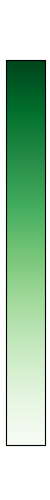

In [25]:
# Baku location
# Sample DataFrame creation (use your actual data here)
df = pd.DataFrame({
    'longitude': np.random.uniform(49.8671-0.05, 49.8671+0.05, 1000),
    'latitude': np.random.uniform(40.4093-0.05, 40.4093+0.05, 1000),
    'uploadSpeed': np.random.uniform(10, 100, 1000)
})

# Extract relevant columns
points = df[['longitude', 'latitude']].values
values = df['uploadSpeed'].values

# Perform Delaunay triangulation
tri = Delaunay(points)

# Normalize upload speeds for color mapping
norm = colors.Normalize(vmin=values.min(), vmax=values.max())
cmap = cm.get_cmap('Greens')

# Create a Folium map centered on Azerbaijan
m = folium.Map(location=[40.4093, 49.8671], zoom_start=13, tiles='CartoDB Positron')

# Add different tile layers for better visual appeal with proper attributions
folium.TileLayer('openstreetmap', attr='&copy; OpenStreetMap contributors').add_to(m)

# Plot the Delaunay triangles with popups for average upload speed
for simplex in tri.simplices:
    triangle = [(points[simplex[i], 1], points[simplex[i], 0]) for i in range(3)]
    triangle_center = np.mean(points[simplex], axis=0)
    avg_speed = values[simplex].mean()

    color = colors.rgb2hex(cmap(norm(avg_speed)))
    popup_content = f"Average Speed: {avg_speed:.2f} Mbps"
    folium.Polygon(
        locations=triangle,
        color='white',
        weight=0.5,
        fill=True,
        fill_color=color,
        fill_opacity=0.5,
        popup=folium.Popup(popup_content, max_width=300),
    ).add_to(m)

# Add circles at each point position
for index, row in df.iterrows():
    folium.Circle(
        location=[row['latitude'], row['longitude']],
        radius=20,  # Radius of the circle in meters
        color='white',
        weight=0.5,
        fill_opacity=0.6,
        opacity=1,
        fill_color='green',
        fill=True,
    ).add_to(m)

# Add layer control to switch between different tile layers
folium.LayerControl().add_to(m)

# Add search widget
folium.plugins.Geocoder().add_to(m)

# Add fullscreen option
folium.plugins.Fullscreen(
    position="topright",
    title="Expand me",
    title_cancel="Exit me",
    force_separate_button=True,
).add_to(m)

# Create a color bar using matplotlib
fig, ax = plt.subplots(figsize=(0.5, 5))  # Narrower and vertical
norm = plt.Normalize(vmin=0, vmax=10)  # Example normalization
cbar = plt.colorbar(cm.ScalarMappable(norm=norm, cmap=cmap), cax=ax, orientation='vertical')
cbar.set_label('Upload Speed (Mbps)', fontsize=10)

# Set facecolor of the figure to transparent
fig.patch.set_facecolor('none')

# Remove ticks
cbar.ax.set_yticks([])

cbar.set_label('Upload Speed (Mbps)', fontsize=10, color='white')
plt.close(fig)



# Convert color bar to HTML
color_bar_html = fig_to_html(fig)

# Define legend HTML with color bar
legend_html = f'''
    <div style="position: relative; z-index: 9999;">
        <div style="position: absolute; left: 0; top: 7em; opacity: 0.5 "> {color_bar_html} </div>
    </div> '''

# Add legend HTML to the map
m.get_root().html.add_child(folium.Element(legend_html))

# Save to an HTML file
m.save('upload_speed_map_with_legend_and_colorbar_vertical.html')

# Display the map (if using Jupyter Notebook)
m

### Send to server

In [26]:
# filename = "User upload speed graph.html"
# m.save(filename)

# import requests

# def send_file_to_server(file_path, server_url):
#     try:
#         with open(file_path, 'rb') as file:
#             files = {'file': file}
#             response = requests.post(server_url, files=files)
#             if response.status_code == 200:
#                 print("File sent successfully.")
#             else:
#                 print("Failed to send file. Status code:", response.status_code)
#     except IOError as e:
#         print("Error:", e)

# # Example usage
#  # Path to the file you want to send
# server_url = 'http://192.168.161.152:8080/visualisation'  # URL of the server to send the file
# send_file_to_server(filename, server_url)

### Distribution of number of tests by region

In [42]:
np.random.seed(0)
df = pd.DataFrame({
    'longitude': np.random.uniform(49.8671 - 0.05, 49.8671 + 0.05, 1000),
    'latitude': np.random.uniform(40.4093 - 0.05, 40.4093 + 0.05, 1000),
    'hour': np.random.randint(0, 24, 1000)
})

# Baku location
m = folium.Map(location=[40.4093, 49.8671], zoom_start=13, tiles='CartoDB Positron')

# Marker cluster for better performance
marker_cluster = MarkerCluster().add_to(m)

# Add markers to the marker cluster
for index, row in df.iterrows():
    folium.Marker([row['latitude'], row['longitude']],
                  popup=f"Hour: {row['hour']}",
                  icon=folium.Icon(color='blue', icon='info-sign')).add_to(marker_cluster)

# Group points by hour for TimeSliderChoropleth
grouped = df.groupby('hour')
data = {}
for hour, group in grouped:
    data[str(hour)] = group[['latitude', 'longitude']].values.tolist()

# Prepare styledict for TimeSliderChoropleth
styledict = {
    str(hour): {
        'color': 'blue', 
        'icon': 'circle',
        'iconstyle': {
            'fillColor': 'blue',
            'fillOpacity': 0.6,
            'stroke': 'true',
            'radius': 5
        }
    } for hour in grouped.groups
}

# Create TimeSliderChoropleth
TimeSliderChoropleth(data, styledict=styledict).add_to(m)

# Add layer control to switch between different tile layers
folium.LayerControl().add_to(m)

# Save to an HTML file
m.save('upload_speed_map_with_time_slider.html')

# Display the map (if using Jupyter Notebook)
m

### Antennae Importance

C:\Users\Emin K\AppData\Local\Temp\ipykernel_2064\1148793477.py:42: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap('viridis')


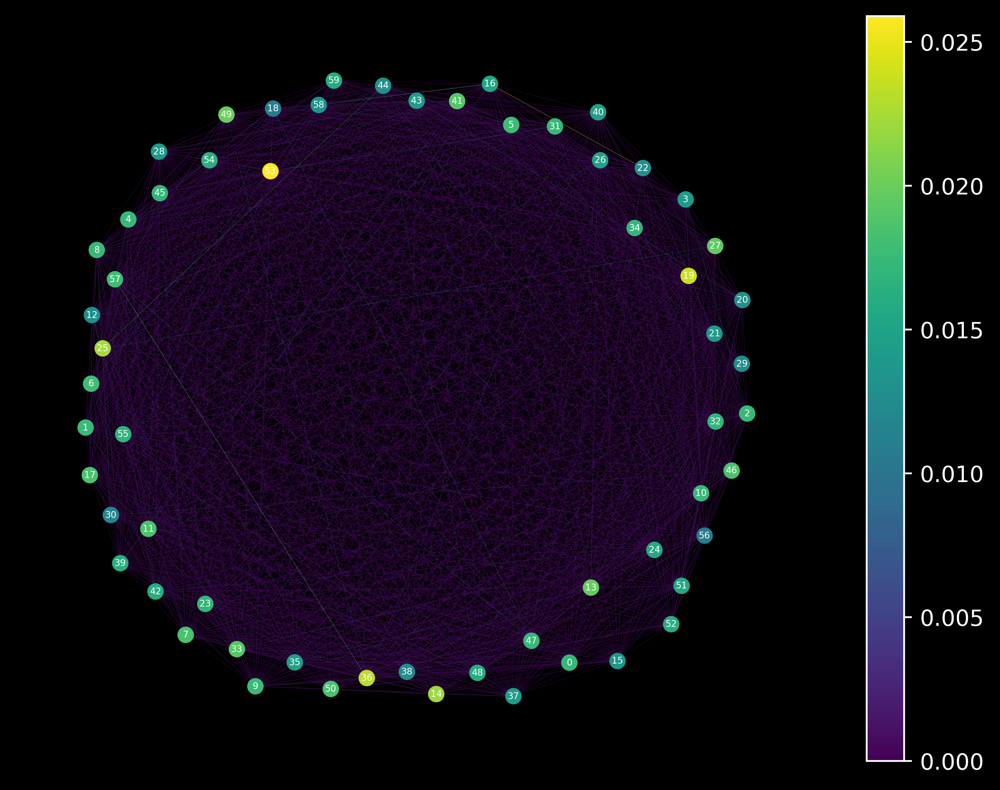

In [28]:
# Create the DataFrame with random antennae points
df_antennae = pd.DataFrame({
    'longitude': np.random.uniform(49.8671-0.05, 49.8671+0.05, 60),
    'latitude': np.random.uniform(40.4093-0.05, 40.4093+0.05, 60),
})

# Create a graph
G = nx.Graph()

# Add nodes to the graph
for idx, row in df_antennae.iterrows():
    G.add_node(idx, longitude=row['longitude'], latitude=row['latitude'])

# Create edges based on the threshold distance
for i in range(len(df_antennae)):
    for j in range(i + 1, len(df_antennae)):
        dist = euclidean((df_antennae.iloc[i]['longitude'], df.iloc[i]['latitude']),
                         (df_antennae.iloc[j]['longitude'], df.iloc[j]['latitude']))
        G.add_edge(i, j, weight=1/dist)

# Calculate PageRank
google_matrix = nx.google_matrix(G)
pagerank = np.array(list(nx.pagerank(G).values()))
pos = nx.kamada_kawai_layout(G)

# Assuming G is your NetworkX graph
google_matrix = nx.google_matrix(G)
pagerank = np.array(list(nx.pagerank(G).values()))
pos = nx.spring_layout(G, 42)

def draw():
    # Calculate edge transparency
    alphas = np.multiply(google_matrix.T, pagerank) / 100
    
    # Normalize alphas to ensure values are between 0 and 1
    alphas = alphas / alphas.max()

    # Flatten alphas for edge coloring
    alphas_flat = alphas.flatten()

    # Convert normalized alphas to RGBA colors using a colormap
    cmap = cm.get_cmap('viridis')
    edge_colors = cmap(alphas_flat)

    plt.figure(figsize=(8, 6), dpi=500, facecolor='black', edgecolor='black')

    ax = plt.gca()
    ax.set_facecolor('black')

    nx.draw_networkx_nodes(G, pos=pos, 
                           node_color=pagerank, 
                           vmin=0, vmax=pagerank.max(),
                           cmap='viridis', node_size=40)

    nx.draw_networkx_edges(G, pos=pos, 
                           edge_color=edge_colors,
                           width=0.2, alpha=0.5, arrows=False)
    
    nx.draw_networkx_labels(G, pos=pos, font_color="white", font_size=4)

    sm = plt.cm.ScalarMappable(cmap='viridis', norm=None)
    sm.set_array([])  # Dummy array for the colorbar
    sm.set_clim(vmin=0, vmax=pagerank.max())
    cbar = plt.colorbar(sm, ax=ax)
    cbar.outline.set_edgecolor('white')  # Change colorbar outline to white
    cbar.ax.yaxis.set_tick_params(color='white')  # Change colorbar ticks to white
    plt.setp(plt.getp(cbar.ax.axes, 'yticklabels'), color='white')  # Change colorbar labels to white

    plt.show()

# Call the draw function
draw()


### Upload speed map (in theory)

C:\Users\Emin K\AppData\Local\Temp\ipykernel_2064\3236160627.py:31: UserWarning: The following kwargs were not used by contour: 'interpolation'
  contour = plt.contourf(X, Y, Z, cmap='viridis', levels=100, interpolation='bilinear')  # Adjust interpolation method as needed


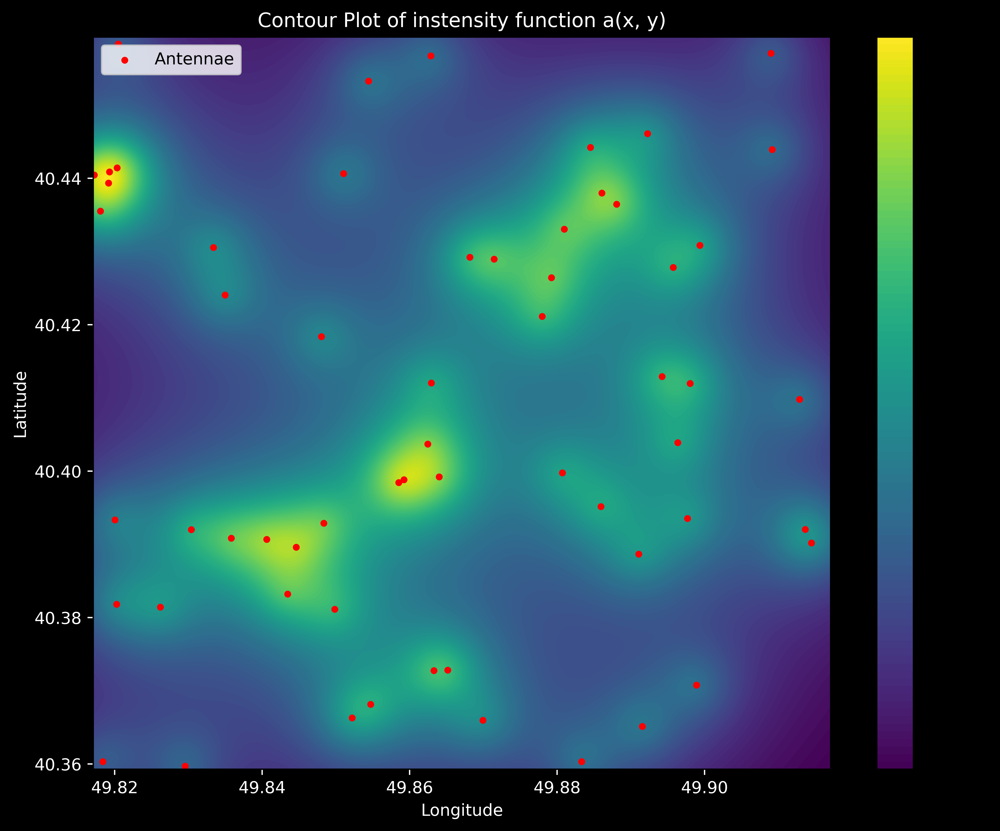

In [29]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Convert the DataFrame to a numpy array
antennae = df_antennae.to_numpy()
antennae_count = len(antennae)
precision = 500

# Define the function
def a(x, y):
    point = np.array([x, y])
    difference = antennae - point
    distance = np.linalg.norm(difference, axis=1)
    cost = 1 / ((distance**2) + 1/(precision**2) * antennae_count**(1/2))  # regularization
    return np.sum(cost)

# Generate grid points for the contour plot
x = np.linspace(49.8171, 49.9171, precision)
y = np.linspace(40.3593, 40.4593, precision)
X, Y = np.meshgrid(x, y)
Z = np.zeros(X.shape)

# Calculate the function values over the grid
for i in range(X.shape[0]):
    for j in range(X.shape[1]):
        Z[i, j] = a(X[i, j], Y[i, j])

# Plot the contour plot with interpolation for smoothness
plt.figure(figsize=(10, 8), dpi=500, facecolor='black', edgecolor='black')
contour = plt.contourf(X, Y, Z, cmap='viridis', levels=100, interpolation='bilinear')  # Adjust interpolation method as needed
plt.colorbar(contour)
plt.scatter(antennae[:, 0], antennae[:, 1], color='red', s=10, label='Antennae')
plt.xlabel('Longitude', color="white")
plt.ylabel('Latitude', color="white")
plt.tick_params(axis='x', colors='white')
plt.tick_params(axis='y', colors='white')
plt.title('Contour Plot of instensity function a(x, y)', color="white")
plt.legend()
plt.show()


### Upload Map (superimposed)


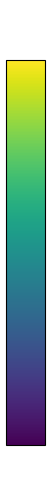

In [30]:
# Convert the DataFrame to a numpy array
antennae = df_antennae.to_numpy()
antennae_count = len(antennae)
precision = 50  # Adjust precision for better performance on the map

# Define the function
def a(x, y):
    point = np.array([x, y])
    difference = antennae - point
    distance = np.linalg.norm(difference, axis=1)
    cost = 1 / ((distance**2) + 1/((precision**2)*(antennae_count**(1/2))))  # regularization
    return np.sum(cost)

# Generate grid points for the contour plot
x = np.linspace(49.8171, 49.9171, precision)
y = np.linspace(40.3593, 40.4593, precision)
X, Y = np.meshgrid(x, y)
Z = np.zeros(X.shape)

# Calculate the function values over the grid
for i in range(X.shape[0]):
    for j in range(X.shape[1]):
        Z[i, j] = a(X[i, j], Y[i, j])

# Normalize the function values for color mapping
norm = Normalize(vmin=Z.min(), vmax=Z.max())
cmap = viridis

# Create a Folium map
m = folium.Map(location=[40.4093, 49.8671], zoom_start=13)

# Add rectangles to the map
for i in range(precision-1):
    for j in range(precision-1):
        top_left = [Y[i, j], X[i, j]]
        bottom_right = [Y[i+1, j+1], X[i+1, j+1]]
        color = ScalarMappable(norm=norm, cmap=cmap).to_rgba(Z[i, j], bytes=True)
        color = f'#{color[0]:02x}{color[1]:02x}{color[2]:02x}'
        folium.Rectangle(bounds=[top_left, bottom_right], color=color, fill=True, fill_opacity=0.5, weight=0).add_to(m)

# Add antennae markers to the map with IDs and PageRank as marker size
for index, row in df_antennae.iterrows():
    antenna_id = index
    pagerank_value = pagerank[antenna_id]  # Get PageRank value or default to 0 if not available
    tooltip_content = f"Antenna ID: {antenna_id},\nPageRank: {pagerank_value}"
    marker_size = pagerank_value * 100  # The higher is pagerank
    folium.CircleMarker(location=[row['latitude'], row['longitude']], radius=marker_size, color='red', fill=True, fill_opacity=1, tooltip=tooltip_content).add_to(m)


# Create a color bar using matplotlib
fig, ax = plt.subplots(figsize=(0.5, 5))  # Narrower and vertical
norm = plt.Normalize(vmin=0, vmax=10)  # Example normalization
cbar = plt.colorbar(cm.ScalarMappable(norm=norm, cmap=cmap), cax=ax, orientation='vertical')
cbar.set_label('Upload Speed (Mbps)', fontsize=10)

# Set facecolor of the figure to transparent
fig.patch.set_facecolor('none')

# Remove ticks
cbar.ax.set_yticks([])
cbar.set_label('Upload Speed (Mbps)', fontsize=10, color='white')
plt.close(fig)

# Convert color bar to HTML
color_bar_html = fig_to_html(fig)

# Define legend HTML with color bar
legend_html = f'''
    <div style="position: relative; z-index: 9999;">
        <div style="position: absolute; left: 0; top: 7em; opacity: 0.5 "> {color_bar_html} </div>
    </div> '''

# Add legend HTML to the map
m.get_root().html.add_child(folium.Element(legend_html))


# Save the map to an HTML file
m.save('folium_map_with_rectangular_grid.html')
m

### Upload speed map (based User-data)

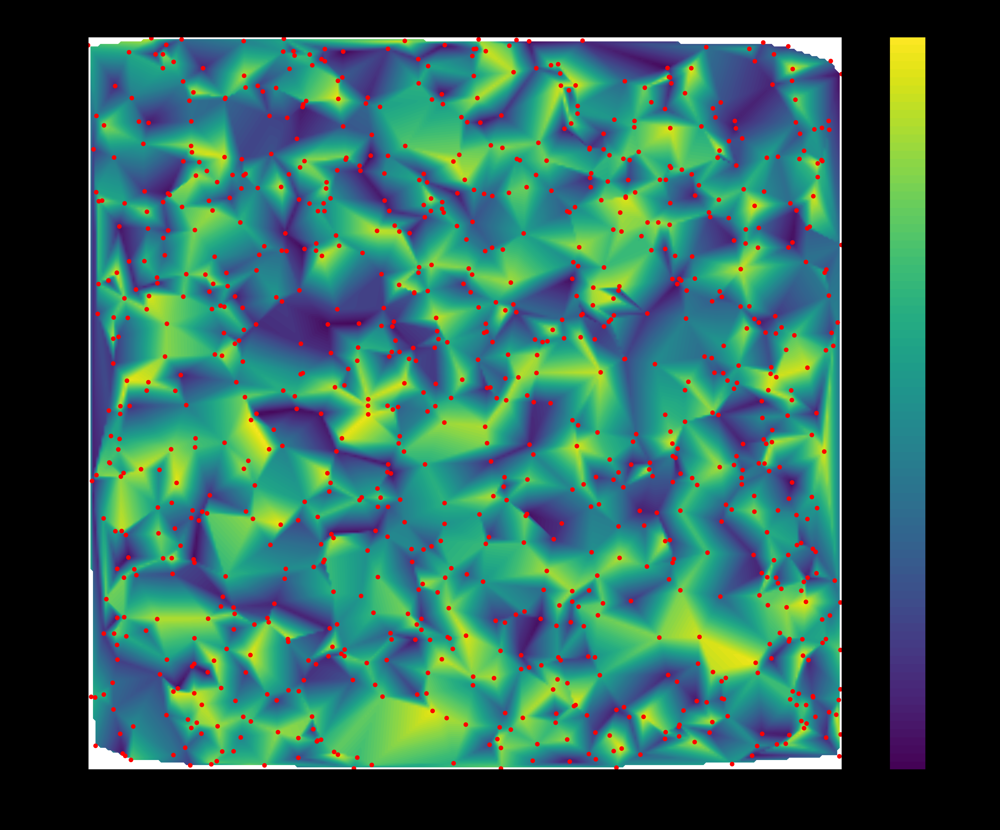

In [31]:
# Extract data for interpolation
points = df[['longitude', 'latitude']].values
values = df['uploadSpeed'].values

# Create grid for interpolation with higher resolution
grid_lon, grid_lat = np.mgrid[49.8171:49.9171:300j, 40.3593:40.4593:300j]

# Perform the interpolation
grid_speed = griddata(points, values, (grid_lon, grid_lat), method='linear') # in real data, nearest will have more accuracy

# Ensure that upload speeds are non-negative
grid_speed = np.maximum(grid_speed, 0)

# Plot the results using contourf
plt.figure(figsize=(10, 8), dpi=500, facecolor='black', edgecolor='black')
contour = plt.contourf(grid_lon, grid_lat, grid_speed, levels=100, cmap='viridis')  # Increase number of levels for smoother contour
cbar = plt.colorbar(contour, label='Upload Speed')
cbar.ax.tick_params(labelsize=12)  # Increase the color bar tick font size
plt.scatter(df['longitude'], df['latitude'], color='red', s=10, linewidth=0, edgecolor='black')  # Adjust scatter plot point size and edge color
plt.title('2D Interpolation of Upload Speed via user tests', fontsize=16)  # Increase the title font size
plt.xlabel('Longitude', fontsize=14)  # Increase the x-axis label font size
plt.ylabel('Latitude', fontsize=14)  # Increase the y-axis label font size
plt.tight_layout()  # Adjust layout to prevent clipping of labels
plt.show()


### Anomaly detection

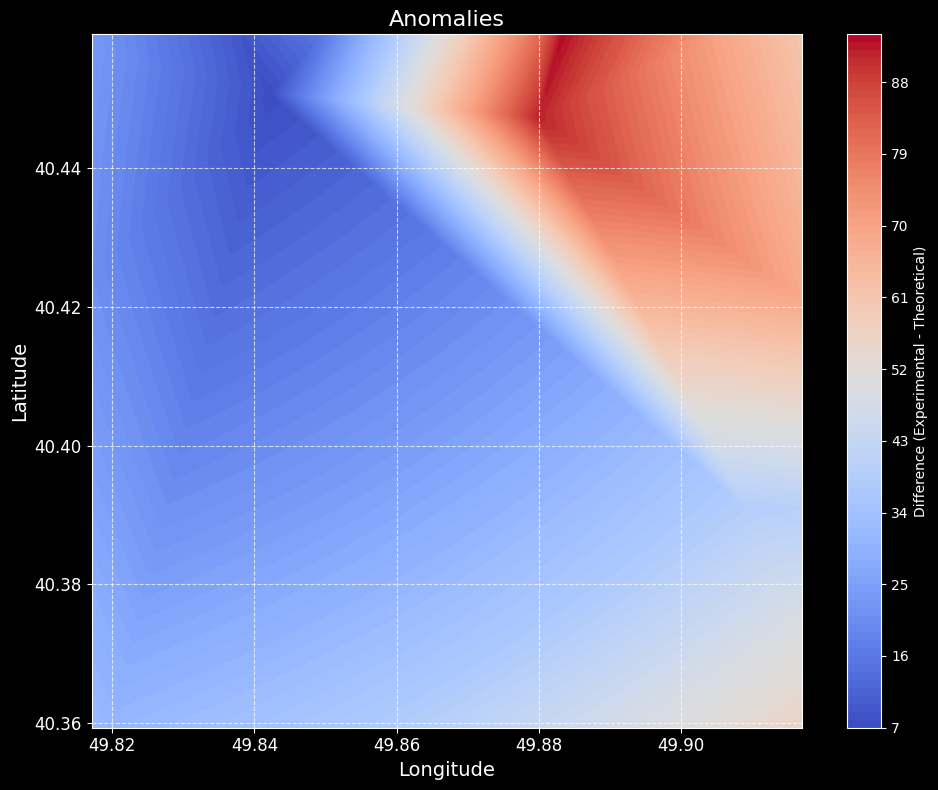

In [40]:
# Extract data for interpolation
points = df[['longitude', 'latitude']].values
values = df['uploadSpeed'].values

# Create grid for interpolation with higher resolution
grid_lon, grid_lat = np.mgrid[49.8171:49.9171:300j, 40.3593:40.4593:300j]

# Perform the interpolation
grid_speed = griddata(points, values, (grid_lon, grid_lat), method='linear') # in real data, nearest will have more accuracy

# Ensure that upload speeds are non-negative
grid_speed = np.maximum(grid_speed, 0)

# Define the function for theoretical model
def a(x, y):
    point = np.array([x, y])
    difference = antennae - point
    distance = np.linalg.norm(difference, axis=1)
    cost = 1 / ((distance**2) + 1/(precision**2) * antennae_count**(1/2))  # regularization
    return np.sum(cost)

# Generate grid points for the contour plot for theoretical model
x_theo = np.linspace(49.8171, 49.9171, precision)
y_theo = np.linspace(40.3593, 40.4593, precision)
X_theo, Y_theo = np.meshgrid(x_theo, y_theo)
Z_theo = np.zeros(X_theo.shape)

# Calculate the function values over the grid for theoretical model
for i in range(X_theo.shape[0]):
    for j in range(X_theo.shape[1]):
        Z_theo[i, j] = a(X_theo[i, j], Y_theo[i, j])

# Normalize the theoretical data
mean_Z_theo = np.mean(Z_theo)
std_Z_theo = np.std(Z_theo)
Z_theo_normalized = (Z_theo - mean_Z_theo) / std_Z_theo

# Interpolate Z_theo_normalized to match the grid size of grid_speed_normalized
Z_theo_normalized_interp = griddata((X_theo.flatten(), Y_theo.flatten()), Z_theo_normalized.flatten(), (grid_lon, grid_lat), method='cubic')

# Optional: Plot the difference between experimental and theoretical data
difference = grid_speed - Z_theo_normalized_interp
plt.figure(figsize=(10, 8))
contour_diff = plt.contourf(grid_lon, grid_lat, difference, levels=100, cmap='coolwarm')  # Use diverging colormap to highlight differences
plt.colorbar(contour_diff, label='Difference (Experimental - Theoretical)')
plt.title('Anomalies', fontsize=16)
plt.xlabel('Longitude', fontsize=14)
plt.ylabel('Latitude', fontsize=14)
plt.tick_params(axis='both', which='major', labelsize=12)
plt.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

### Antennae Clustering

In [33]:
# Clustering

df = pd.read_csv('dataset.csv')

# Label encoding
label_encoding = LabelEncoder()
df['operator'] = label_encoding.fit_transform(df['operator'])
df['deviceType'] = label_encoding.fit_transform(df['deviceType'])

# Preprocessing: Standardizing the data
features = ['longitude', 'latitude', 'latency', 'downloadSpeed', 'uploadSpeed', 'operator', 'deviceType', 'packetLoss']
x = df.loc[:, features].values
x = StandardScaler().fit_transform(x)

# Performing PCA
pca = PCA(n_components=3)
principalComponents = pca.fit_transform(x)
principalDf = pd.DataFrame(data=principalComponents, columns=['PC1', 'PC2', 'PC3'])

# Clustering: K-means
kmeans = KMeans(n_clusters=6)  # according to elbow should be 2 or 6
kmeans.fit(principalDf)
labels = kmeans.labels_

# Adding PCA components and cluster labels to the original dataframe
df['PC1'] = principalDf['PC1']
df['PC2'] = principalDf['PC2']
df['PC3'] = principalDf['PC3']
df['Cluster'] = labels

# Visualizing the PCA result with clusters in 3D
fig = px.scatter_3d(
    df, x='PC1', y='PC2', z='PC3',
    color='Cluster',
    title='3D PCA of Upload Speeds with K-means Clustering',
    labels={'PC1': 'Principal Component 1', 'PC2': 'Principal Component 2', 'PC3': 'Principal Component 3'}
)

# Set dark theme
fig.update_layout(template='plotly_dark')

fig.show()

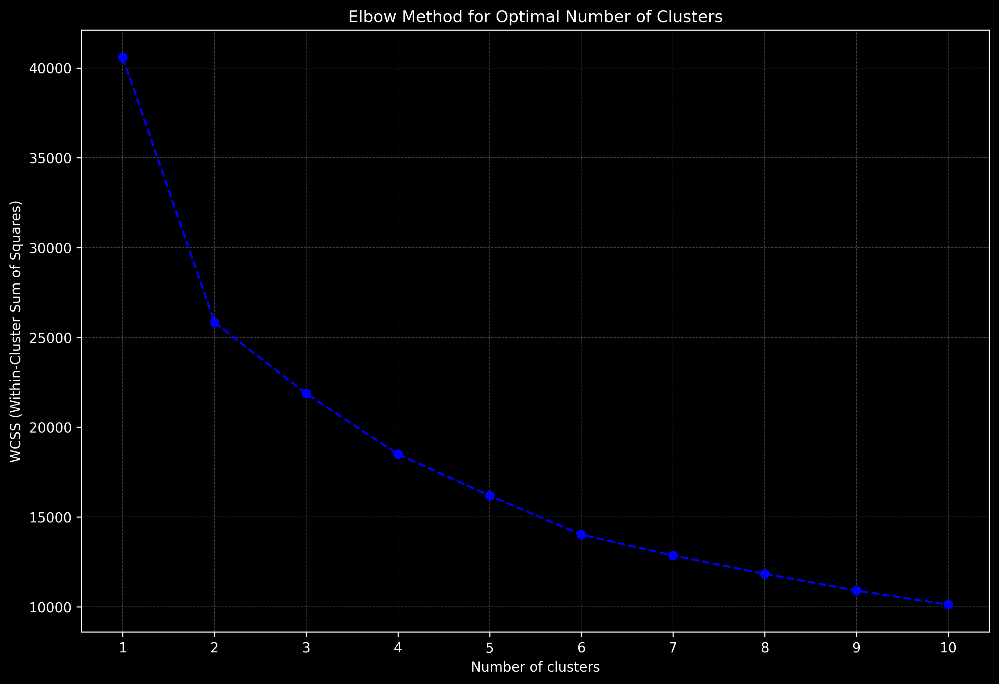

In [34]:
# Determine the optimal number of clusters using the elbow method
wcss = []
max_clusters = 10
for i in range(1, max_clusters + 1):
    kmeans = KMeans(n_clusters=i, random_state=42)
    kmeans.fit(principalDf)
    wcss.append(kmeans.inertia_)

# Set style to dark background
plt.style.use('dark_background')

# Increase DPI
plt.figure(figsize=(12, 8), dpi=300)

# Plot the elbow method
plt.plot(range(1, max_clusters + 1), wcss, marker='o', linestyle='--', color='blue')
plt.title('Elbow Method for Optimal Number of Clusters', color='white')
plt.xlabel('Number of clusters', color='white')
plt.ylabel('WCSS (Within-Cluster Sum of Squares)', color='white')
plt.xticks(range(1, max_clusters + 1), color='white')
plt.yticks(color='white')
plt.grid(True, color='gray', linestyle='--', linewidth=0.5, alpha=0.5)
plt.show()
